In [1]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from tqdm import tqdm


In [2]:
from google.colab import drive
drive.mount('content')

Drive already mounted at content; to attempt to forcibly remount, call drive.mount("content", force_remount=True).


In [3]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [4]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 15389775685981775584, name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14674281152
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 6971367695152682670
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"]

In [5]:
filepath = '/content/content/MyDrive/Songs/Somebody Made For Me.mp3'
y, sr = librosa.load(filepath, sr = 22050)
print('\n')
N = len(y)
print('Length of File in Samples: ', N)
time_of_song = N/sr
print('Time of Song in Second: ', time_of_song)

video_frame_rate = 60
video_frame_period = 1/video_frame_rate
# we need 60 pictures per second
total_spectrograms = int(video_frame_rate*time_of_song)
print('Number of Spectrograms Required: ', total_spectrograms)
samples_per_spectrogram = int(N/total_spectrograms)
print('Samples per Spectrogram: ', samples_per_spectrogram)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")




Length of File in Samples:  2978245
Time of Song in Second:  135.06780045351474
Number of Spectrograms Required:  8104
Samples per Spectrogram:  367


Streaming output truncated to the last 5000 lines.

 68%|██████▊   | 5238/7737 [15:09<06:53,  6.04it/s]

 68%|██████▊   | 5239/7737 [15:09<06:55,  6.01it/s]

 68%|██████▊   | 5240/7737 [15:09<06:51,  6.06it/s]

 68%|██████▊   | 5241/7737 [15:09<06:50,  6.08it/s]

 68%|██████▊   | 5242/7737 [15:09<06:44,  6.17it/s]

 68%|██████▊   | 5243/7737 [15:10<06:52,  6.05it/s]

 68%|██████▊   | 5244/7737 [15:10<06:59,  5.94it/s]

 68%|██████▊   | 5245/7737 [15:10<07:05,  5.86it/s]

 68%|██████▊   | 5246/7737 [15:10<06:57,  5.96it/s]

 68%|██████▊   | 5247/7737 [15:10<07:00,  5.93it/s]

 68%|██████▊   | 5248/7737 [15:10<06:55,  5.99it/s]

 68%|██████▊   | 5249/7737 [15:11<06:59,  5.92it/s]

 68%|██████▊   | 5250/7737 [15:11<06:53,  6.01it/s]

 68%|██████▊   | 5251/7737 [15:11<06:49,  6.07it/s]

 68%|██████▊   | 5252/7737 [15:11<06:49,  6.07it/s]

 68%|██████▊   | 5253/7737 [15:11<06:44,  6.15it/s]

 68%|██████▊   | 5254/7737 [15:11<06:48,  6.07it/s]

 68%|██████▊   | 5255/7737 [15:12<06:53,  6.01i

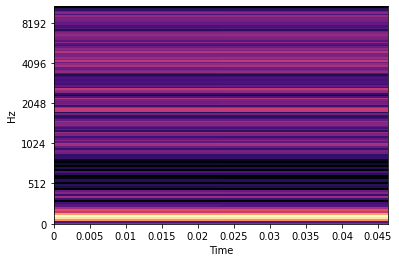

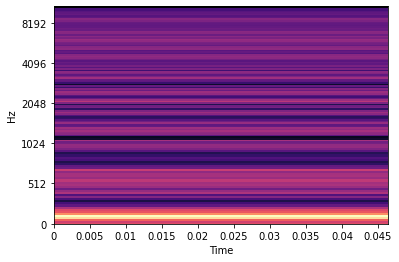

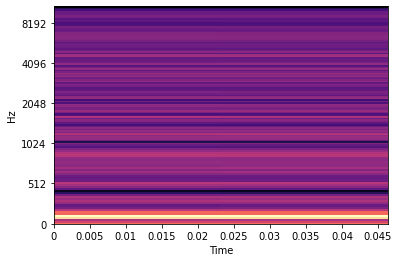

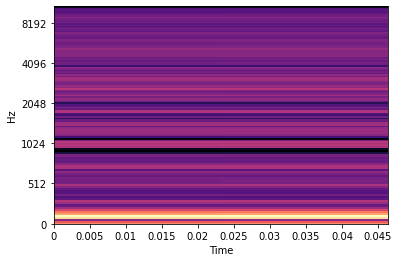

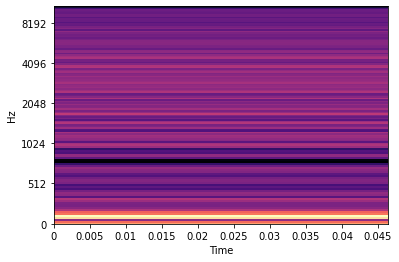

...

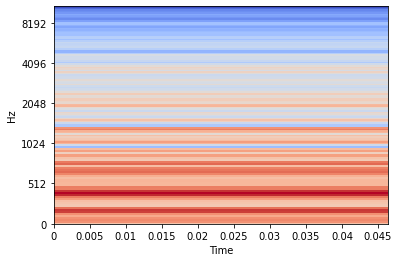

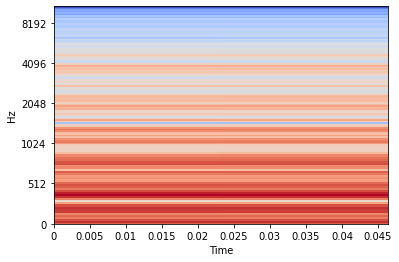

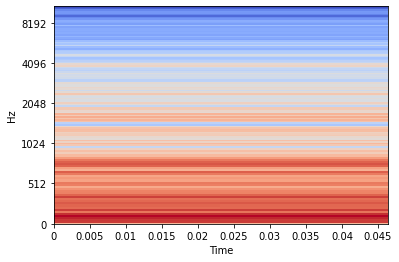

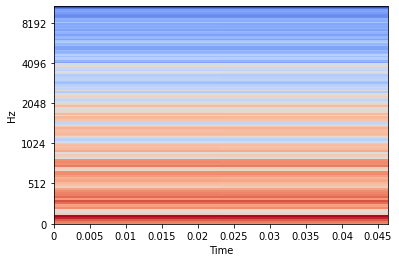

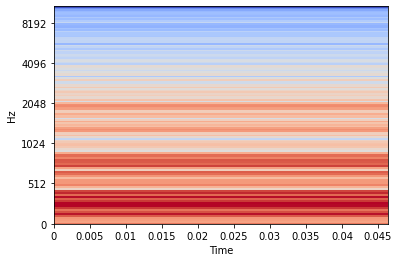

In [ ]:
hop_length = samples_per_spectrogram
n_fft = 2048

iterations = (total_spectrograms-hop_length)
for i in tqdm(range(iterations)):
  signal = y[i*hop_length:(i+1)*hop_length]
  melspec = librosa.feature.melspectrogram(signal, sr = sr, n_fft=n_fft, hop_length=hop_length)
  fig, ax = plt.subplots()
  S_dB = librosa.power_to_db(melspec)
  img = librosa.display.specshow(S_dB, x_axis='time',y_axis='mel', sr=sr, ax=ax)
  plt.savefig('/content/content/MyDrive/Pictures/image_'+str(i), dpi = 100)
  number_of_figures = i

In [19]:
!pip install moviepy
import glob
import moviepy.video.io.ImageSequenceClip

image_folder = '/content/content/MyDrive/Pictures/*.png'
fps = video_frame_rate

image_files = []
for name in glob.glob(image_folder):
  image_files.append(name)
clip = moviepy.video.io.ImageSequenceClip.ImageSequenceClip(image_files, fps=fps)
clip.write_videofile('my_video.mp4')

[MoviePy] >>>> Building video my_video.mp4
[MoviePy] Writing video my_video.mp4


100%|██████████| 7737/7737 [02:31<00:00, 51.03it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: my_video.mp4 



In [21]:
import moviepy.editor as mp

audio = mp.AudioFileClip(filepath)
video1 = mp.VideoFileClip('my_video.mp4')
final = video1.set_audio(audio)
final.write_videofile("my_video_with_audio.mp4")

[MoviePy] >>>> Building video my_video_with_audio.mp4
[MoviePy] Writing audio in my_video_with_audioTEMP_MPY_wvf_snd.mp3


100%|██████████| 2979/2979 [00:04<00:00, 711.47it/s]

[MoviePy] Done.
[MoviePy] Writing video my_video_with_audio.mp4



100%|██████████| 7737/7737 [01:39<00:00, 77.84it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: my_video_with_audio.mp4 

